# Analysis on Global Food & Agriculture Statistics

The data source location is https://www.kaggle.com/datasets/unitednations/global-food-agriculture-statistics?resource=download.

The data set provided by FAOSTAT and it has access to over 3 million time-series and cross sectional data relating to food and agriculture. We took three data sets from above source First dataset has data about the crops, the second one has a land data and last one is production indices.

* Dataset 1: Crops data
https://www.kaggle.com/datasets/unitednations/global-food-agriculture-statistics/data?select=fao_data_crops_data.csv
* Dataset 2: Land data
https://www.kaggle.com/datasets/unitednations/global-food-agriculture-statistics/data?select=fao_data_land_data.csv
* Dataset 3: Production Indices data
https://www.kaggle.com/datasets/unitednations/global-food-agriculture-statistics/data?select=fao_data_production_indices_data.csv

We collected this data source from a website called Kaggle (https://www.kaggle.com/).

README:

* Data Collection: Gathering and cleaning the raw data with exception handling using multiple python libraries and built in functions.

* Data Cleaning: Applying various cleaning methods to fill the null values, checking for duplicate values and edge cases.

* Visualization and Hypothesis: Creating charts and plots to visualize the results and proving the hypothesis using different type of charts ,plots.

In [50]:
import pandas as pd  # imported required libraries
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.express as px
import plotly.io as pio
import geopandas as gpd

In [51]:
pip install gdown

DATASET 1 : LOADING

In [52]:
import pandas as pd
import gdown

def download_and_load_csv(drive_url):
    """
    Downloads a CSV file from Google Drive and loads it into a DataFrame.

    Parameters:
    drive_url (str): The shareable link to the CSV file on Google Drive.

    Returns:
    pandas.DataFrame or None: A DataFrame if the CSV file is successfully loaded. Returns None if an error occurs.
    """
    try:
        # Extract the file ID from the shareable link
        file_id = drive_url.split('/d/')[1].split('/')[0]
        # Create the direct download link
        download_url = f"https://drive.google.com/uc?id={file_id}"
        
        # Download the file
        output = 'temp.csv'
        gdown.download(download_url, output, quiet=False)
        
        # Load the CSV file into a DataFrame
        df = pd.read_csv(output)
        return df
    except Exception as e:
        print(f"An error occurred: {e}")
        return None

# Example shareable link (replace with your actual link)
drive_url = "https://drive.google.com/file/d/1iqO-qj_Cop_6p_bUgt0OSx9jVI1zWXYh/view"

# Download and load the CSV
df_crops = download_and_load_csv(drive_url)

if df_crops is not None:
    print("Data loaded successfully!")
    print(df_crops.head())  # Display the first few rows of the DataFrame
else:
    print("Data could not be loaded.")

Downloading...
From (original): https://drive.google.com/uc?id=1iqO-qj_Cop_6p_bUgt0OSx9jVI1zWXYh
From (redirected): https://drive.google.com/uc?id=1iqO-qj_Cop_6p_bUgt0OSx9jVI1zWXYh&confirm=t&uuid=641df468-9e94-46cb-9e8c-d7da8141c6cd
To: C:\Users\lokes\Documents\temp.csv
100%|██████████| 154M/154M [00:03<00:00, 44.9MB/s] 


Data loaded successfully!
  country_or_area element_code         element    year unit    value  \
0      Americas +           31  Area Harvested  2007.0   Ha  49404.0   
1      Americas +           31  Area Harvested  2006.0   Ha  49404.0   
2      Americas +           31  Area Harvested  2005.0   Ha  49404.0   
3      Americas +           31  Area Harvested  2004.0   Ha  49113.0   
4      Americas +           31  Area Harvested  2003.0   Ha  48559.0   

  value_footnotes          category  
0              A   agave_fibres_nes  
1              A   agave_fibres_nes  
2              A   agave_fibres_nes  
3              A   agave_fibres_nes  
4              A   agave_fibres_nes  


UNDERSTANDING ABOUT DATASET 1

In [53]:
df_crops.head(10) # displaying the first 10 rows of data frame

,country_or_area,element_code,element,year,unit,value,value_footnotes,category
0,Americas +,31,Area Harvested,2007.0,Ha,49404.0,A,agave_fibres_nes
1,Americas +,31,Area Harvested,2006.0,Ha,49404.0,A,agave_fibres_nes
2,Americas +,31,Area Harvested,2005.0,Ha,49404.0,A,agave_fibres_nes
3,Americas +,31,Area Harvested,2004.0,Ha,49113.0,A,agave_fibres_nes
4,Americas +,31,Area Harvested,2003.0,Ha,48559.0,A,agave_fibres_nes
5,Americas +,31,Area Harvested,2002.0,Ha,48506.0,A,agave_fibres_nes
6,Americas +,31,Area Harvested,2001.0,Ha,47767.0,A,agave_fibres_nes
7,Americas +,31,Area Harvested,2000.0,Ha,48747.0,A,agave_fibres_nes
8,Americas +,31,Area Harvested,1999.0,Ha,46978.0,A,agave_fibres_nes
9,Americas +,31,Area Harvested,1998.0,Ha,48571.0,A,agave_fibres_nes


In [54]:
df_crops.info() # Getting information about data set

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2255349 entries, 0 to 2255348
Data columns (total 8 columns):
 #   Column           Dtype  
---  ------           -----  
 0   country_or_area  object 
 1   element_code     object 
 2   element          object 
 3   year             float64
 4   unit             object 
 5   value            float64
 6   value_footnotes  object 
 7   category         object 
dtypes: float64(2), object(6)
memory usage: 137.7+ MB


In [55]:
df_crops.describe() # getting a summary statistics table for the DataFrame

,year,value
count,2.254385e+06,2.254385e+06
mean,1.984476e+03,1.502604e+06
std,1.364689e+01,1.951985e+07
min,1.961000e+03,0.000000e+00
25%,1.973000e+03,8.500000e+02
50%,1.985000e+03,1.374200e+04
75%,1.996000e+03,1.031890e+05
max,2.007000e+03,2.351396e+09


In [56]:
# Checking total number of rows and columns of a data frame
num_rows, num_columns = df_crops.shape
print(f"Total number of rows: {num_rows}")
print(f"Total number of columns: {num_columns}")

Total number of rows: 2255349
Total number of columns: 8


In [57]:
df_crops.columns

Index(['country_or_area', 'element_code', 'element', 'year', 'unit', 'value',
       'value_footnotes', 'category'],
      dtype='object')

In [58]:
duplicates = df_crops.duplicated()

# Printing the number of duplicate rows
print("Number of duplicate rows:", duplicates.sum())

# Displaying the duplicate rows
print("Duplicate rows:")
print(df_crops[duplicates])

Number of duplicate rows: 0
Duplicate rows:
Empty DataFrame
Columns: [country_or_area, element_code, element, year, unit, value, value_footnotes, category]
Index: []


HANDLING NULL VALUES FOR DATASET 1

In [59]:
df_crops.isnull().sum() # getting total number of null values in each column

country_or_area         0
element_code            0
element               964
year                  964
unit                  964
value                 964
value_footnotes    479382
category                0
dtype: int64

In [60]:
def clean_dataframe(df):
    """
    Cleans the given DataFrame by performing the following operations:
    1. Drops rows where 'element', 'year', 'unit', or 'value' columns have NaN values.
    2. Fills NaN values in the 'value_footnotes' column with 'NR'.
    3. Removes rows where the 'country or area' column contains a '+' symbol.

    Parameters:
    df (pd.DataFrame): The DataFrame to be cleaned.

    Returns:
    pd.DataFrame: The cleaned DataFrame.
    """
    # Droping rows with NaN values in specified columns
    df.dropna(subset=['element', 'year', 'unit', 'value'], inplace=True)
    
    # Filling NaN values in 'value_footnotes' column with 'NR'
    df['value_footnotes'].fillna('NR', inplace=True)
    
    # Removing rows where 'country or area' column contains a '+'
    df = df[~df['country_or_area'].str.contains('\+')]
    
    return df

# Applying the function to DataFrame
df_crops = clean_dataframe(df_crops)

In [61]:
df_crops.isnull().sum() # checking for null values

country_or_area    0
element_code       0
element            0
year               0
unit               0
value              0
value_footnotes    0
category           0
dtype: int64

DATA TYPE CONVERSION FOR DATASET 1

In [62]:
df_crops.dtypes # getting the data types of each columns

country_or_area     object
element_code        object
element             object
year               float64
unit                object
value              float64
value_footnotes     object
category            object
dtype: object

In [63]:
def convert_dataframe(df):
    """
    Converts the DataFrame by performing the following operations:
    1. Converting 'element_code', 'year', and 'value' columns to category.

    Parameters:
    df (pd.DataFrame): The DataFrame to be converted.

    Returns:
    pd.DataFrame: The converted DataFrame.
    """
    # Convert columns to integers
    df['year'] = df['year'].astype(int)
    df['value'] = df['value'].astype(int)
    # converted columns to categoricl data type
    df['category'] = df['category'].astype('category')
    df['country_or_area'] = df['country_or_area'].astype('category')
    df['element'] = df['element'].astype('category')
    df['element_code'] = df['element_code'].astype('category')
    df['unit'] = df['unit'].astype('category')
    
    return df

# Applied the function to DataFrame
df_crops = convert_dataframe(df_crops)

In [64]:
df_crops.dtypes # checking for data types

country_or_area    category
element_code       category
element            category
year                  int32
unit               category
value                 int32
value_footnotes      object
category           category
dtype: object

DATASET 2 : LOADING

In [65]:
import pandas as pd
import gdown

def download_and_load_csv(drive_url):
    """
    Downloads a CSV file from Google Drive and loads it into a DataFrame.

    Parameters:
    drive_url (str): The shareable link to the CSV file on Google Drive.

    Returns:
    pandas.DataFrame or None: A DataFrame if the CSV file is successfully loaded. Returns None if an error occurs.
    """
    try:
        # Extract the file ID from the shareable link
        file_id = drive_url.split('/d/')[1].split('/')[0]
        # Create the direct download link
        download_url = f"https://drive.google.com/uc?id={file_id}"
        
        # Download the file
        output = 'temp.csv'
        gdown.download(download_url, output, quiet=False)
        
        # Load the CSV file into a DataFrame
        df = pd.read_csv(output)
        return df
    except Exception as e:
        print(f"An error occurred: {e}")
        return None

# Example shareable link (replace with your actual link)
drive_url = "https://drive.google.com/file/d/1lUvfbswucc8h7WV9-DrZfaMycbo31rNr/view"

# Download and load the CSV
df_Agriculture_Land = download_and_load_csv(drive_url)

if df_Agriculture_Land is not None:
    print("Data loaded successfully!")
    print(df_crops.head())  # Display the first few rows of the DataFrame
else:
    print("Data could not be loaded.")

Downloading...
From: https://drive.google.com/uc?id=1lUvfbswucc8h7WV9-DrZfaMycbo31rNr
To: C:\Users\lokes\Documents\temp.csv
100%|██████████| 27.5M/27.5M [00:05<00:00, 5.50MB/s]


Data loaded successfully!
    country_or_area element_code         element  year unit  value  \
564        Colombia           31  Area Harvested  2007   Ha  17500   
565        Colombia           31  Area Harvested  2006   Ha  17500   
566        Colombia           31  Area Harvested  2005   Ha  17500   
567        Colombia           31  Area Harvested  2004   Ha  17294   
568        Colombia           31  Area Harvested  2003   Ha  17094   

    value_footnotes          category  
564              F   agave_fibres_nes  
565              F   agave_fibres_nes  
566              F   agave_fibres_nes  
567              NR  agave_fibres_nes  
568              NR  agave_fibres_nes  


UNDERSTANDING ABOUT DATASET 2

In [66]:
df_Agriculture_Land.head(10) # displaying the first 10 rows of data frame

,country_or_area,element_code,element,year,unit,value,value_footnotes,category
0,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2007.0,1000 Int. $,2486910.0,A,agriculture_pin
1,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2006.0,1000 Int. $,2278516.0,A,agriculture_pin
2,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2005.0,1000 Int. $,2524097.0,A,agriculture_pin
3,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2004.0,1000 Int. $,2226346.0,A,agriculture_pin
4,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2003.0,1000 Int. $,2289434.0,A,agriculture_pin
5,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2002.0,1000 Int. $,2216530.0,A,agriculture_pin
6,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2001.0,1000 Int. $,1863022.0,A,agriculture_pin
7,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2000.0,1000 Int. $,1935142.0,A,agriculture_pin
8,Afghanistan,152,Gross Production 1999-2001 (1000 I$),1999.0,1000 Int. $,2345362.0,A,agriculture_pin
9,Afghanistan,152,Gross Production 1999-2001 (1000 I$),1998.0,1000 Int. $,2373424.0,A,agriculture_pin


In [67]:
df_Agriculture_Land.info() # Getting information about data set

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311634 entries, 0 to 311633
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   country_or_area  311634 non-null  object 
 1   element_code     311634 non-null  object 
 2   element          311624 non-null  object 
 3   year             311624 non-null  float64
 4   unit             311624 non-null  object 
 5   value            311624 non-null  float64
 6   value_footnotes  311624 non-null  object 
 7   category         311634 non-null  object 
dtypes: float64(2), object(6)
memory usage: 19.0+ MB


In [68]:
df_Agriculture_Land.describe() # getting a summary statistics table for the DataFrame

,year,value
count,311624.000000,3.116240e+05
mean,1984.575219,4.021553e+06
std,13.661817,3.617312e+07
min,1961.000000,0.000000e+00
25%,1973.000000,8.400000e+01
50%,1985.000000,1.080000e+02
75%,1997.000000,2.813400e+04
max,2007.000000,1.692538e+09


In [69]:
# Checking total number of rows and columns of a data frame
num_rows, num_columns = df_Agriculture_Land.shape
print(f"Total number of rows: {num_rows}")
print(f"Total number of columns: {num_columns}")

Total number of rows: 311634
Total number of columns: 8


Checking for duplicates

In [70]:
duplicates = df_Agriculture_Land.duplicated()

# Printing boolean series indicating duplicates
print(duplicates)

# Printing the number of duplicate rows
print("Number of duplicate rows:", duplicates.sum())

# Displaying the duplicate rows
print("Duplicate rows:")
print(df_Agriculture_Land[duplicates])

0         False
1         False
2         False
3         False
4         False
          ...  
311629    False
311630    False
311631    False
311632    False
311633    False
Length: 311634, dtype: bool
Number of duplicate rows: 0
Duplicate rows:
Empty DataFrame
Columns: [country_or_area, element_code, element, year, unit, value, value_footnotes, category]
Index: []


HANDLING NULL VALUES FOR DATASET 2

In [71]:
df_Agriculture_Land.isnull().sum() # getting total number of null values in each column

country_or_area     0
element_code        0
element            10
year               10
unit               10
value              10
value_footnotes    10
category            0
dtype: int64

In [72]:
def clean_dataframe(df):
    """
    Cleans the given DataFrame by performing the following operations:
    1. Drops rows where 'element', 'year', 'unit', or 'value' columns have NaN values.
    2. Fills NaN values in the 'value_footnotes' column with 'NR'.
    3. Removes rows where the 'country or area' column contains a '+' symbol.

    Parameters:
    df (pd.DataFrame): The DataFrame to be cleaned.

    Returns:
    pd.DataFrame: The cleaned DataFrame.
    """
    # Droping rows with NaN values in specified columns
    df.dropna(subset=['element', 'year', 'unit', 'value'], inplace=True)
    
    # Filling NaN values in 'value_footnotes' column with 'NR'
    df['value_footnotes'].fillna('NR', inplace=True)
    
    # Removing rows where 'country or area' column values contains a '+'
    df = df[~df['country_or_area'].str.contains('\+')]
    
    return df

# Applying the function to DataFrame
df_Agriculture_Land = clean_dataframe(df_Agriculture_Land)

In [73]:
df_Agriculture_Land.isnull().sum()

country_or_area    0
element_code       0
element            0
year               0
unit               0
value              0
value_footnotes    0
category           0
dtype: int64

DATA TYPE CONVERSION FOR DATASET 2

In [74]:
df_Agriculture_Land.dtypes # getting the data types of each columns

country_or_area     object
element_code        object
element             object
year               float64
unit                object
value              float64
value_footnotes     object
category            object
dtype: object

In [75]:
def convert_dataframe(df):
    """
    Converts the DataFrame by performing the following operations:
    1. Converting 'element_code' and 'year' columns to category.

    Parameters:
    df (pd.DataFrame): The DataFrame to be converted.

    Returns:
    pd.DataFrame: The converted DataFrame.
    """
    # Converting 'year'column to integers
    df['year'] = df['year'].astype(int)
    # converted columns to categoricl data type
    df['category'] = df['category'].astype('category')
    df['country_or_area'] = df['country_or_area'].astype('category')
    df['element'] = df['element'].astype('category')
    df['element_code'] = df['element_code'].astype('category')
    df['unit'] = df['unit'].astype('category')
    
    
    return df

# Applying the function to DataFrame
df_Agriculture_Land = convert_dataframe(df_Agriculture_Land)

In [76]:
df_Agriculture_Land.dtypes # getting the data types of each columns

country_or_area    category
element_code       category
element            category
year                  int32
unit               category
value               float64
value_footnotes      object
category           category
dtype: object

DATASET 3 : LOADING

In [77]:
import pandas as pd
import gdown

def download_and_load_csv(drive_url):
    """
    Downloads a CSV file from Google Drive and loads it into a DataFrame.

    Parameters:
    drive_url (str): The shareable link to the CSV file on Google Drive.

    Returns:
    pandas.DataFrame or None: A DataFrame if the CSV file is successfully loaded. Returns None if an error occurs.
    """
    try:
        # Extract the file ID from the shareable link
        file_id = drive_url.split('/d/')[1].split('/')[0]
        # Create the direct download link
        download_url = f"https://drive.google.com/uc?id={file_id}"
        
        # Download the file
        output = 'temp.csv'
        gdown.download(download_url, output, quiet=False)
        
        # Load the CSV file into a DataFrame
        df = pd.read_csv(output)
        return df
    except Exception as e:
        print(f"An error occurred: {e}")
        return None

# Example shareable link (replace with your actual link)
drive_url = "https://drive.google.com/file/d/1lUvfbswucc8h7WV9-DrZfaMycbo31rNr/view"

# Download and load the CSV
df_Agriculture_production = download_and_load_csv(drive_url)

if df_Agriculture_production is not None:
    print("Data loaded successfully!")
    print(df_crops.head())  # Display the first few rows of the DataFrame
else:
    print("Data could not be loaded.")

Downloading...
From: https://drive.google.com/uc?id=1lUvfbswucc8h7WV9-DrZfaMycbo31rNr
To: C:\Users\lokes\Documents\temp.csv
100%|██████████| 27.5M/27.5M [00:00<00:00, 37.2MB/s]


Data loaded successfully!
    country_or_area element_code         element  year unit  value  \
564        Colombia           31  Area Harvested  2007   Ha  17500   
565        Colombia           31  Area Harvested  2006   Ha  17500   
566        Colombia           31  Area Harvested  2005   Ha  17500   
567        Colombia           31  Area Harvested  2004   Ha  17294   
568        Colombia           31  Area Harvested  2003   Ha  17094   

    value_footnotes          category  
564              F   agave_fibres_nes  
565              F   agave_fibres_nes  
566              F   agave_fibres_nes  
567              NR  agave_fibres_nes  
568              NR  agave_fibres_nes  


UNDERSTANDING ABOUT DATASET 3

In [78]:
df_Agriculture_production.head(10) # displaying the first 10 rows of data frame

,country_or_area,element_code,element,year,unit,value,value_footnotes,category
0,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2007.0,1000 Int. $,2486910.0,A,agriculture_pin
1,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2006.0,1000 Int. $,2278516.0,A,agriculture_pin
2,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2005.0,1000 Int. $,2524097.0,A,agriculture_pin
3,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2004.0,1000 Int. $,2226346.0,A,agriculture_pin
4,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2003.0,1000 Int. $,2289434.0,A,agriculture_pin
5,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2002.0,1000 Int. $,2216530.0,A,agriculture_pin
6,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2001.0,1000 Int. $,1863022.0,A,agriculture_pin
7,Afghanistan,152,Gross Production 1999-2001 (1000 I$),2000.0,1000 Int. $,1935142.0,A,agriculture_pin
8,Afghanistan,152,Gross Production 1999-2001 (1000 I$),1999.0,1000 Int. $,2345362.0,A,agriculture_pin
9,Afghanistan,152,Gross Production 1999-2001 (1000 I$),1998.0,1000 Int. $,2373424.0,A,agriculture_pin


In [79]:
df_Agriculture_production.info() # Getting information about data set

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311634 entries, 0 to 311633
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   country_or_area  311634 non-null  object 
 1   element_code     311634 non-null  object 
 2   element          311624 non-null  object 
 3   year             311624 non-null  float64
 4   unit             311624 non-null  object 
 5   value            311624 non-null  float64
 6   value_footnotes  311624 non-null  object 
 7   category         311634 non-null  object 
dtypes: float64(2), object(6)
memory usage: 19.0+ MB


In [80]:
df_Agriculture_production.describe() # getting a summary statistics table for the DataFrame

,year,value
count,311624.000000,3.116240e+05
mean,1984.575219,4.021553e+06
std,13.661817,3.617312e+07
min,1961.000000,0.000000e+00
25%,1973.000000,8.400000e+01
50%,1985.000000,1.080000e+02
75%,1997.000000,2.813400e+04
max,2007.000000,1.692538e+09


In [81]:
# Checking total number of rows and columns of a data frame
num_rows, num_columns = df_Agriculture_production.shape
print(f"Total number of rows: {num_rows}")
print(f"Total number of columns: {num_columns}")

Total number of rows: 311634
Total number of columns: 8


Checking for duplicates

In [82]:
duplicates = df_Agriculture_production.duplicated()

# Print boolean series indicating duplicates
print(duplicates)

# Print the number of duplicate rows
print("Number of duplicate rows:", duplicates.sum())

# Display the duplicate rows
print("Duplicate rows:")
print(df_Agriculture_production[duplicates])

0         False
1         False
2         False
3         False
4         False
          ...  
311629    False
311630    False
311631    False
311632    False
311633    False
Length: 311634, dtype: bool
Number of duplicate rows: 0
Duplicate rows:
Empty DataFrame
Columns: [country_or_area, element_code, element, year, unit, value, value_footnotes, category]
Index: []


HANDLING NULL VALUES FOR DATASET 3

In [83]:
df_Agriculture_production.isnull().sum() # getting total number of null values in each column

country_or_area     0
element_code        0
element            10
year               10
unit               10
value              10
value_footnotes    10
category            0
dtype: int64

In [84]:
def clean_dataframe(df):
    """
    Cleans the given DataFrame by performing the following operations:
    1. Drops rows where 'element', 'year', 'unit', or 'value' columns have NaN values.
    2. Fills NaN values in the 'value_footnotes' column with 'NR'.
    3. Removes rows where the 'country or area' column values contains a '+' symbol.

    Parameters:
    df (pd.DataFrame): The DataFrame to be cleaned.

    Returns:
    pd.DataFrame: The cleaned DataFrame.
    """
    # Droping rows with NaN values in specified columns
    df.dropna(subset=['element', 'year', 'unit', 'value'], inplace=True)
    
    # Filling NaN values in 'value_footnotes' column with 'NR'
    df['value_footnotes'].fillna('NR', inplace=True)
    
    # Removing rows where 'country or area' column values contains a '+'
    df = df[~df['country_or_area'].str.contains('\+')]
    
    return df

# Applying the function to DataFrame
df_Agriculture_production = clean_dataframe(df_Agriculture_production)

In [85]:
df_Agriculture_production.isnull().sum()

country_or_area    0
element_code       0
element            0
year               0
unit               0
value              0
value_footnotes    0
category           0
dtype: int64

DATA TYPE CONVERSION FOR DATASET 3

In [86]:
df_Agriculture_production.dtypes # checking the data types

country_or_area     object
element_code        object
element             object
year               float64
unit                object
value              float64
value_footnotes     object
category            object
dtype: object

In [87]:
def convert_dataframe(df):
    """
    Converts the DataFrame by performing the following operations:
    1. Converting 'element_code', 'year', and 'value' columns to category.

    Parameters:
    df (pd.DataFrame): The DataFrame to be converted.

    Returns:
    pd.DataFrame: The converted DataFrame.
    """
    # Convert columns to integers
    df['year'] = df['year'].astype(int)
    df['value'] = df['value'].astype(int)
    # converted Category column to categoricl data type
    df['category'] = df['category'].astype('category')
    
    df['country_or_area'] = df['country_or_area'].astype('category')
    df['element'] = df['element'].astype('category')
    df['element_code'] = df['element_code'].astype('category')
    df['unit'] = df['unit'].astype('category')
    
    return df

# Apply the function to your DataFrame
df_Agriculture_production = convert_dataframe(df_Agriculture_production)

In [88]:
df_Agriculture_production.dtypes

country_or_area    category
element_code       category
element            category
year                  int32
unit               category
value                 int32
value_footnotes      object
category           category
dtype: object

# VIZUALIZATIONS

This vizualization depicats the top 10 apple Producing countries

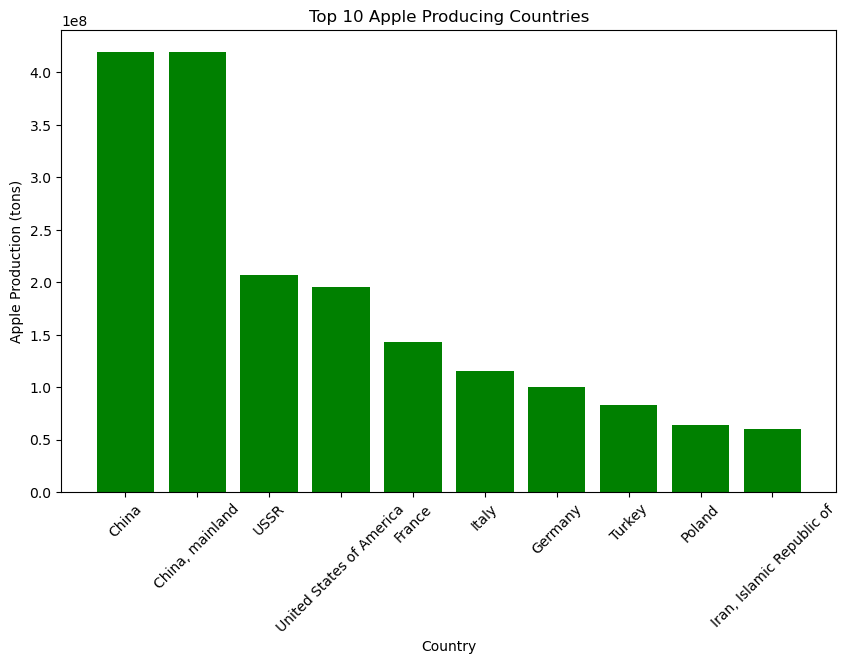

In [89]:
# Filtering data for apple production
df_apples = df_crops[df_crops['category'] == 'apples']

# Group by country and value the production values
apple_production_by_country = df_apples.groupby('country_or_area')['value'].sum().reset_index()

# Sorting
apple_production_by_country = apple_production_by_country.sort_values(by='value', ascending=False)

# filter only top 10
top_10_countries = apple_production_by_country.head(10)

# Pltting a bar chart
plt.figure(figsize=(10, 6))
plt.bar(top_10_countries['country_or_area'], top_10_countries['value'], color='green')
plt.xlabel('Country')
plt.ylabel('Apple Production (tons)')
plt.title('Top 10 Apple Producing Countries')
plt.xticks(rotation=45)  #for better readability
plt.show()


This vizualization depicats to find which year has maximum apples produced. 

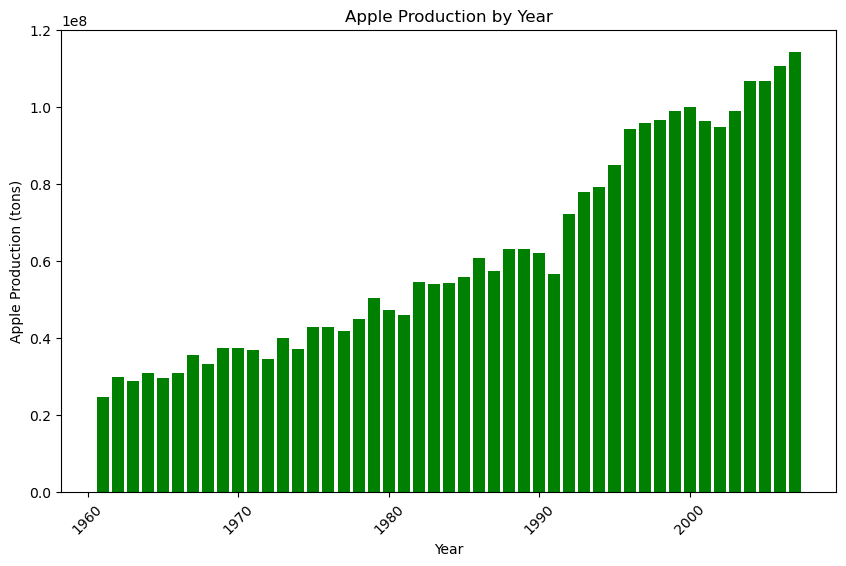

In [90]:
# Group by year and sum the production values
apple_production_by_year = df_apples.groupby('year')['value'].sum().reset_index()

# Create a bar chart
plt.figure(figsize=(10, 6))
plt.bar(apple_production_by_year['year'], apple_production_by_year['value'], color='green')
plt.xlabel('Year')
plt.ylabel('Apple Production (tons)')
plt.title('Apple Production by Year')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()

The below pie chart represents the which crop is grown more worldwide. Top !0 was considered to avoid minimal crops. The percentage represents the percentage of the particular crop to the total crops. We have cereals at the top. 

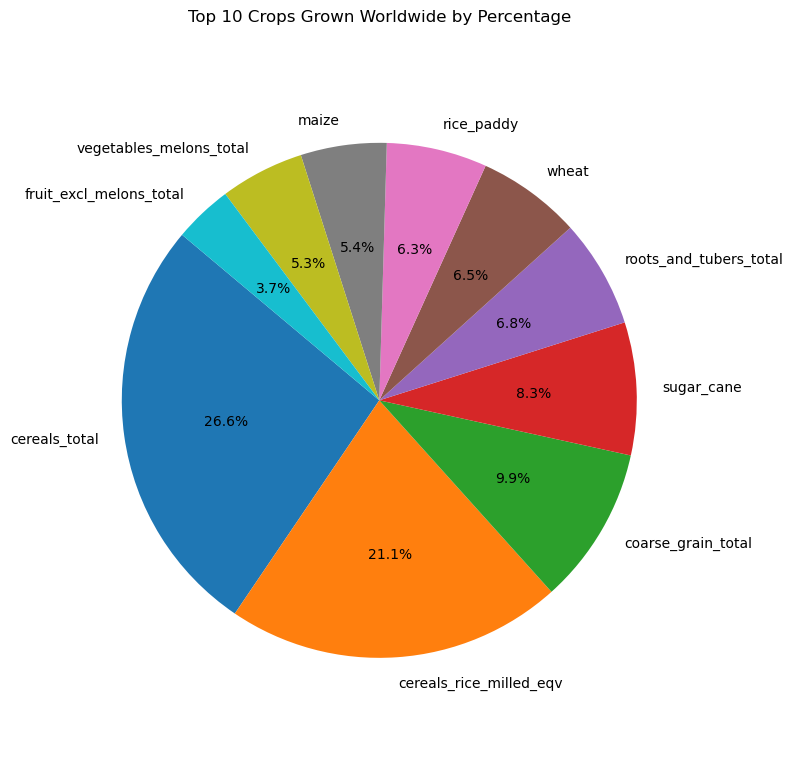

In [91]:
# calculating the total amount if the crops 
crop_totals = df_crops.groupby('category')['value'].sum()

# getting the top 10 crops 
top_10_crops = crop_totals.nlargest(10)

# Ccalculating the percentage of each crop
top_10_crops_percent = (top_10_crops / crop_totals.sum()) * 100

# Plotting the pie chart 
plt.figure(figsize=(8, 8))
plt.pie(top_10_crops_percent, labels=top_10_crops_percent.index, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab10.colors)
plt.title('Top 10 Crops Grown Worldwide by Percentage')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.tight_layout()
plt.show()

Scatter Plot represents the apples grown on different areas by country wise. Agriculture Area and Agriculture area and country area are top most used areas for growing the Apples 


In [92]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [93]:
import dask.dataframe as dd
import plotly.express as px

# Assuming df_crops and df_Agriculture_Land are already defined
df_crops_dd = dd.from_pandas(df_crops, npartitions=10)
df_Agriculture_Land_dd = dd.from_pandas(df_Agriculture_Land, npartitions=10)

# Filter for apples
df_crops_filtered_dd = df_crops_dd[df_crops_dd['category'] == 'apples']

# Merge the datasets
merged_data_dd = dd.merge(df_crops_filtered_dd, df_Agriculture_Land_dd, on=['country_or_area', 'year'])
merged_data = merged_data_dd.compute()

# Create the scatter plot
fig = px.scatter(merged_data, x='country_or_area', y='category_y', 
                 color='category_y', 
                 title='Area Types in which Apples are Grown by Country')
fig.show()


D:\Anaconda_Navigator\New folder\Lib\site-packages\dask\dataframe\multi.py:502: UserWarning:

Merging dataframes with merge column data type mismatches: 
+----------------------------------------+------------+-------------+
| Merge columns                          | left dtype | right dtype |
+----------------------------------------+------------+-------------+
| ('country_or_area', 'country_or_area') | category   | category    |
+----------------------------------------+------------+-------------+
Cast dtypes explicitly to avoid unexpected results.



In [94]:
pip install geopandas

The country which produces cereals were been colored in yellow otherwise in purple. The below world map shows people in the countries have owned cereals in their diets

C:\Users\lokes\AppData\Local\Temp\ipykernel_4484\3902338237.py:10: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.



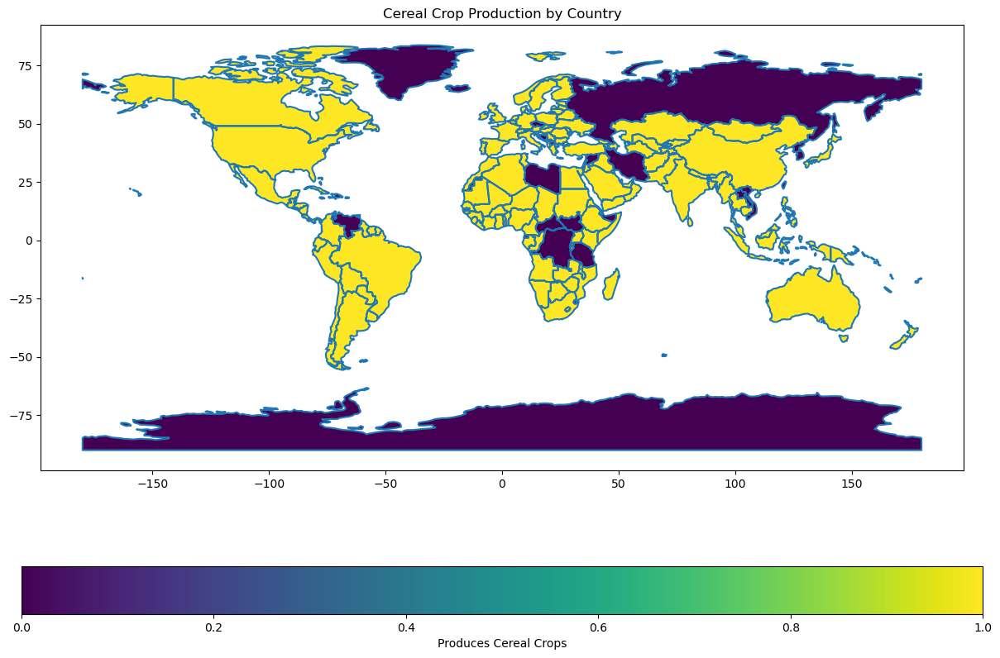

In [95]:
# List of cereal crops
cereal_crops = ["cereals_nes","cereals_rice_milled_eqv","cereals_total"]

# Identify countries that produce at least one cereal crop
df_crops['is_cereal'] = df_crops['category'].isin(cereal_crops)
cereal_producers = df_crops.groupby('country_or_area')['is_cereal'].any().reset_index()
cereal_producers['produces_cereal'] = cereal_producers['is_cereal'].astype(int)

# Load world map data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Merge data on country name
world = world.merge(cereal_producers[['country_or_area', 'produces_cereal']], how='left', left_on='name', right_on='country_or_area')

# filling the country with 0 if they are not producing cereals 
world['produces_cereal'] = world['produces_cereal'].fillna(0)

# Plotting the heatmap
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='produces_cereal', ax=ax, legend=True,
           legend_kwds={'label': "Produces Cereal Crops",
                        'orientation': "horizontal"})

plt.title('Cereal Crop Production by Country')
plt.show()

The country which produces grapes were been colored in brown otherwise in white. The below world map shows people in the countries have owned grapes in their diets

C:\Users\lokes\AppData\Local\Temp\ipykernel_4484\1001126278.py:10: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.



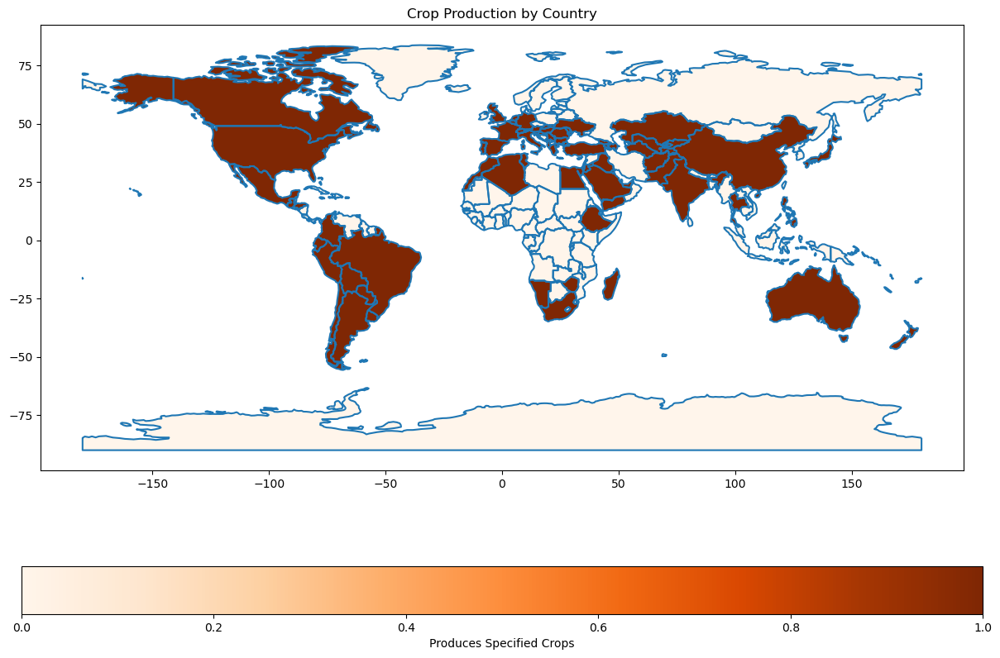

In [96]:
# List of crops
crops = ["grapes"]

# Identify countries that produce at least one of the specified crops
df_crops['is_crop'] = df_crops['category'].isin(crops)
crop_producers = df_crops.groupby('country_or_area')['is_crop'].any().reset_index()
crop_producers['produces_crop'] = crop_producers['is_crop'].astype(int)

# Load world map data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Merge data on country name
world = world.merge(crop_producers[['country_or_area', 'produces_crop']], how='left', left_on='name', right_on='country_or_area')

# filling the country with 0 if they are not producing any of the specified crops
world['produces_crop'] = world['produces_crop'].fillna(0)

# Plotting the heatmap with orange colormap
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='produces_crop', ax=ax, legend=True, cmap='Oranges',
           legend_kwds={'label': "Produces Specified Crops",
                        'orientation': "horizontal"})

plt.title('Crop Production by Country')
plt.show()


The country which produces apples were been colored in blue otherwise in white. The below world map shows people in the countries have owned apples in their diets

C:\Users\lokes\AppData\Local\Temp\ipykernel_4484\2293610332.py:10: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.



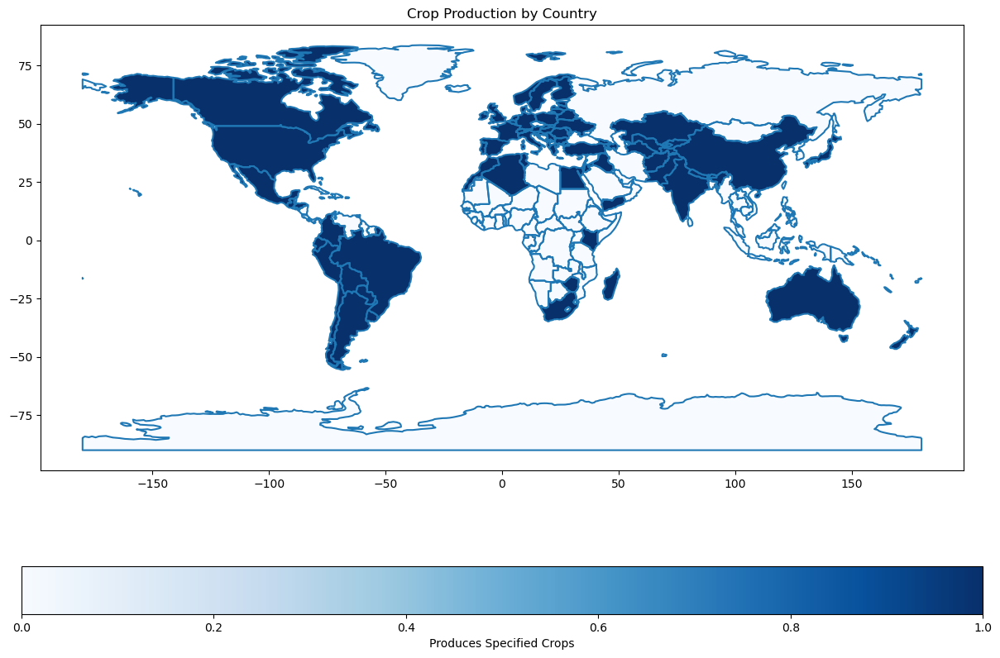

In [97]:
# List of crops
crops = ["apples"]

# Identify countries that produce at least one of the specified crops
df_crops['is_crop'] = df_crops['category'].isin(crops)
crop_producers = df_crops.groupby('country_or_area')['is_crop'].any().reset_index()
crop_producers['produces_crop'] = crop_producers['is_crop'].astype(int)

# Load world map data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Merge data on country name
world = world.merge(crop_producers[['country_or_area', 'produces_crop']], how='left', left_on='name', right_on='country_or_area')

# filling the country with 0 if they are not producing any of the specified crops
world['produces_crop'] = world['produces_crop'].fillna(0)

# Plotting the heatmap with orange colormap
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
world.boundary.plot(ax=ax)
world.plot(column='produces_crop', ax=ax, legend=True, cmap='Blues',
           legend_kwds={'label': "Produces Specified Crops",
                        'orientation': "horizontal"})

plt.title('Crop Production by Country')
plt.show()


# These are some of the terms definition in element column in production indices dataset. which are used in hypothesis.

Gross PIN (base 1999-2001): Gross Production Index Number, a measure of total agricultural production relative to a base period (1999-2001).

Gross Production 1999-2001 (1000 I$): Total value of agricultural production during the base period in international dollars.

Grs per capita PIN (base 1999-2001): Gross Production Index Number per capita, indicating average production per person relative to the base period.

Net per capita PIN (base 1999-2001): Net Production Index Number per capita, indicating average net production per person after accounting for losses and non-food uses, relative to the base period.

Net Production 1999-2001 (1000 I$): Total net value of agricultural production during the base period in international dollars.

Net PIN (base 1999-2001): Net Production Index Number, a measure of net agricultural production (after losses and non-food uses) relative to a base period.

# HYPOTHESIS-1
Does the Net Production Index (Net PIN) exhibit a significant positive trend over time in United States of America, suggesting consistent improvements in overall agricultural production efficiency?

Yes, the Net Production Index (Net PIN) exhibits a significant positive trend over time in United States of America, suggesting consistent improvements in overall agricultural production efficiency.

In the code, data for Net PIN and crop yield is aggregated by country and year, and then merged. The trends for United States of America are visualized using a line plot, demonstrating a clear upward trajectory in Net PIN, indicating enhanced agricultural efficiency.

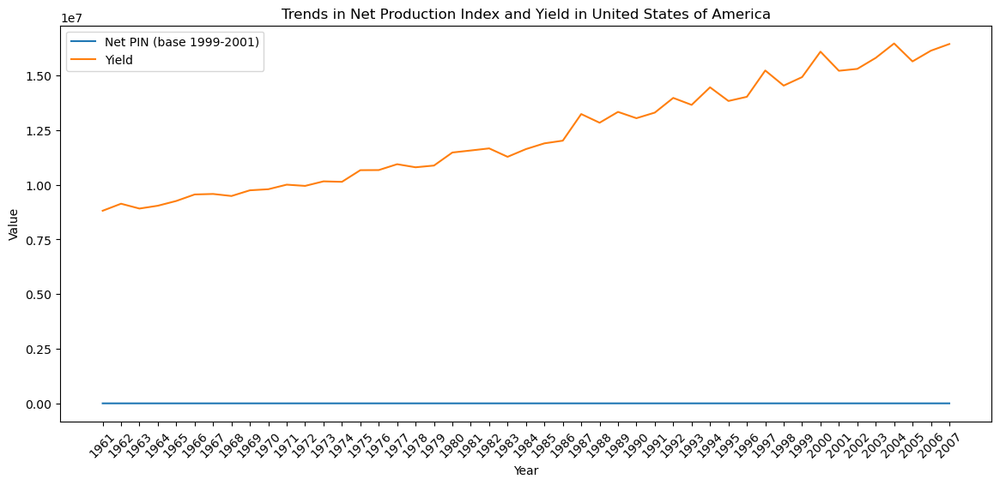

In [98]:
# Aggregating data
net_production_index = df_Agriculture_production[df_Agriculture_production['element'] == 'Net PIN (base 1999-2001)']
crop_yield = df_crops[df_crops['element'] == 'Yield']

net_production_index_agg = net_production_index.groupby(['country_or_area', 'year'])['value'].sum().reset_index()
crop_yield_agg = crop_yield.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Merging data
merged_data = pd.merge(net_production_index_agg, crop_yield_agg, on=['country_or_area', 'year'], suffixes=('_index', '_yield'))

# Plotting example for a specific country
country = 'United States of America'
country_data = merged_data[merged_data['country_or_area'] == country]

plt.figure(figsize=(14, 6))
plt.plot(country_data['year'], country_data['value_index'], label='Net PIN (base 1999-2001)')
plt.plot(country_data['year'], country_data['value_yield'], label='Yield')
plt.xlabel('Year')
plt.ylabel('Value')
plt.xticks(merged_data['year'].unique(), rotation=45)  # Set x-tick labels to be all years with rotation
plt.title(f'Trends in Net Production Index and Yield in {country}')
plt.legend()
plt.show()

# HYPOTHESIS-2
Do countries like India, the United States of America, and China exhibit different trends in net production index (Net PIN) and crop yield over time, indicating variations in agricultural performance and productivity strategies among these nations?

Yes, the countries exhibit different trends in Net Production Index (Net PIN) and crop yield over time, indicating variations in agricultural performance and productivity strategies among India, the United States of America, and China.

In the code, data for Net PIN and crop yield is aggregated by country and year, and then merged. The trends for the selected countries are visualized using a line plot, demonstrating that each country shows distinct patterns in their Net PIN and crop yield, reflecting differences in their agricultural practices and efficiencies.

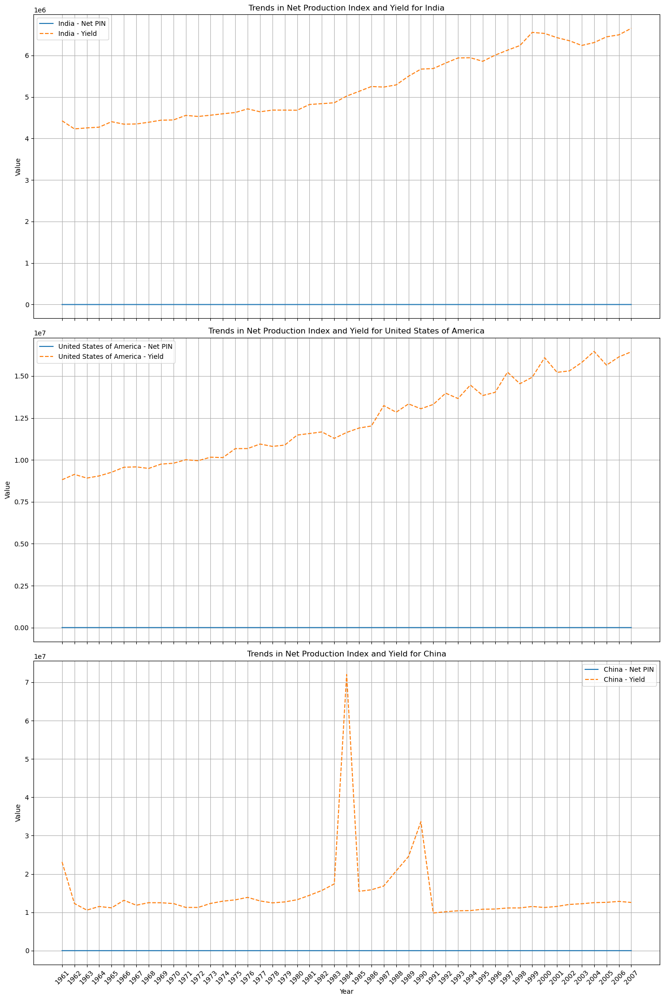

In [99]:
# Aggregating data
net_production_index = df_Agriculture_production[df_Agriculture_production['element'] == 'Net PIN (base 1999-2001)']
crop_yield = df_crops[df_crops['element'] == 'Yield']

net_production_index_agg = net_production_index.groupby(['country_or_area', 'year'])['value'].sum().reset_index()
crop_yield_agg = crop_yield.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Merging data
merged_data = pd.merge(net_production_index_agg, crop_yield_agg, on=['country_or_area', 'year'], suffixes=('_index', '_yield'))

# List of selected countries
selected_countries = ['India', 'United States of America', 'China']

# Create subplots
fig, axs = plt.subplots(len(selected_countries), 1, figsize=(14, 7 * len(selected_countries)), sharex=True)

for i, country in enumerate(selected_countries):
    country_data = merged_data[merged_data['country_or_area'] == country]
    
    axs[i].plot(country_data['year'], country_data['value_index'], label=f'{country} - Net PIN')
    axs[i].plot(country_data['year'], country_data['value_yield'], linestyle='--', label=f'{country} - Yield')
    
    axs[i].set_ylabel('Value')
    axs[i].set_title(f'Trends in Net Production Index and Yield for {country}')
    axs[i].grid(True)
    axs[i].legend()

# Set common x-axis label
plt.xlabel('Year')
plt.xticks(merged_data['year'].unique(), rotation=45)  # Set x-tick labels to be all years with rotation

plt.tight_layout()
plt.show()


# HYPOTHESIS-3
Is there a significant positive correlation between the Net Production Index (base 1999-2001) and crop yield in United States of America, indicating that higher yields contribute to increased overall agricultural production?

Yes, There is a significant positive correlation between the Net Production Index (base 1999-2001) and crop yield in United States of America indicates that as crop yields increase, overall agricultural production also tends to increase.

In the code, data for Net Production Index and crop yield is aggregated by country and year, and then merged. The trends for United States of America are visualized using a bar plot. 

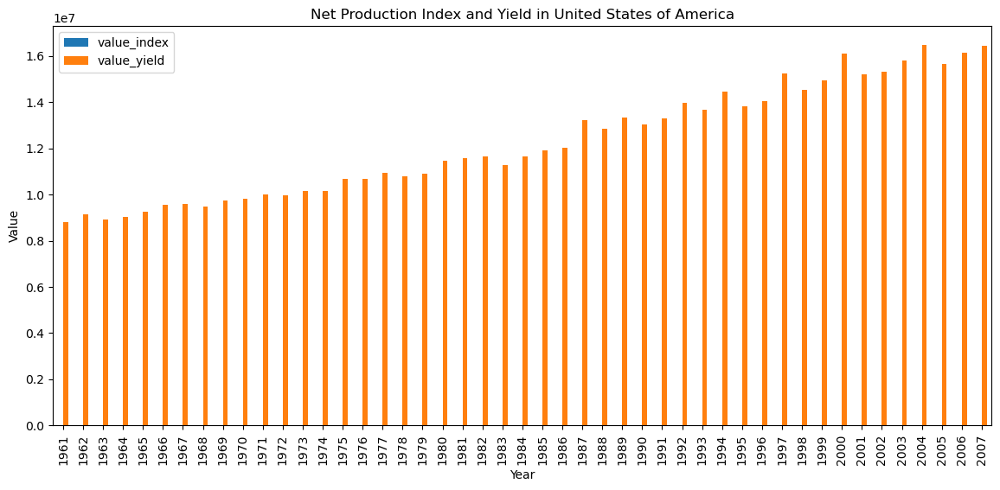

In [100]:
# Aggregating data
net_production_index = df_Agriculture_production[df_Agriculture_production['element'] == 'Net PIN (base 1999-2001)']
crop_yield = df_crops[df_crops['element'] == 'Yield']

net_production_index_agg = net_production_index.groupby(['country_or_area', 'year'])['value'].sum().reset_index()
crop_yield_agg = crop_yield.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Merging data
merged_data = pd.merge(net_production_index_agg, crop_yield_agg, on=['country_or_area', 'year'], suffixes=('_index', '_yield'))

# Bar plot for a specific country
country = 'United States of America'
country_data = merged_data[merged_data['country_or_area'] == country]

country_data.plot(x='year', y=['value_index', 'value_yield'], kind='bar', figsize=(14, 6))
plt.xlabel('Year')
plt.ylabel('Value')
plt.title(f'Net Production Index and Yield in {country}')
plt.show()

# HYPOTHESIS-4
Is there a significant positive correlation between crop diversity and Gross PIN (base 1999-2001) in United States of America, suggesting that higher crop diversity leads to increased agricultural productivity and economic output?

Yes, there is a significant positive correlation between crop diversity and Gross PIN (base 1999-2001) in United States of America, indicating that as crop diversity increases, overall agricultural productivity and economic output also tend to increase.

In the code, data for Gross PIN and crop diversity is aggregated by country and year, and then merged. The trends for United States of America are visualized using a box plot.

<Figure size 1400x700 with 0 Axes>

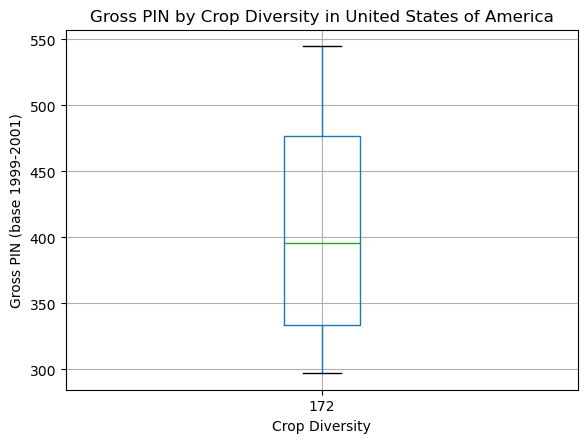

In [101]:
# Aggregating data
crop_types = df_crops.groupby(['country_or_area', 'year', 'category'])['value'].sum().reset_index()
gross_PIN = df_Agriculture_production[df_Agriculture_production['element'] == 'Gross PIN (base 1999-2001)']

gross_PIN_agg = gross_PIN.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Counting the number of unique crop categories per year and country
crop_diversity = crop_types.groupby(['country_or_area', 'year'])['category'].nunique().reset_index()
crop_diversity.columns = ['country_or_area', 'year', 'crop_diversity']

# Merging data
merged_data = pd.merge(crop_diversity, gross_PIN_agg, on=['country_or_area', 'year'])

# Box plot for a specific country
country = 'United States of America'
country_data = merged_data[merged_data['country_or_area'] == country]

plt.figure(figsize=(14, 7))
country_data.boxplot(column='value', by='crop_diversity')
plt.xlabel('Crop Diversity')
plt.ylabel('Gross PIN (base 1999-2001)')
plt.title(f'Gross PIN by Crop Diversity in {country}')
plt.suptitle('')
plt.show()

# HYPOTHESIS-5
Do the distributions of Gross PIN (base 1999-2001) differ significantly among India, the United States of America, China, and Japan, indicating variations in agricultural productivity and economic growth among these countries?

Yes, the distributions of Gross PIN (base 1999-2001) differ significantly among India, the United States of America, China, and Japan, indicating variations in agricultural productivity and economic growth among these countries.

In the code, data for Gross PIN is filtered and aggregated by country and year for the selected countries. The distributions are visualized using a violin plot to show the variability and density of Gross PIN for each country.

Selected countries in data: ['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Angola', ..., 'Western Sahara', 'Yemen', 'Yugoslav SFR', 'Zambia', 'Zimbabwe']
Length: 220
Categories (220, object): ['Afghanistan', 'Albania', 'Algeria', 'American Samoa', ..., 'Yemen', 'Yugoslav SFR', 'Zambia', 'Zimbabwe']


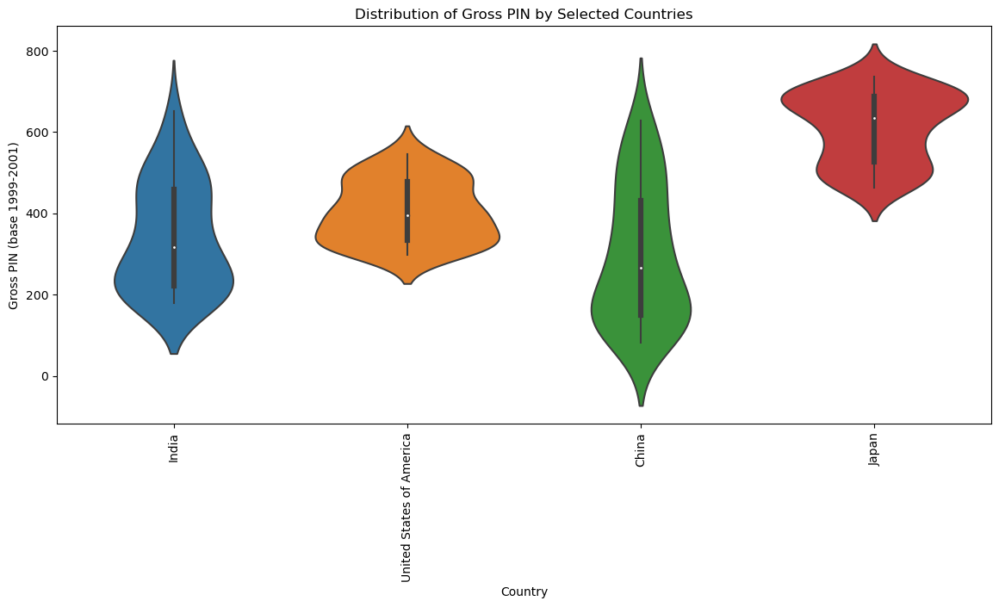

In [102]:
# Assuming df_Agriculture_production is your DataFrame

# Filter data for 'Gross PIN (base 1999-2001)'
gross_PIN = df_Agriculture_production[df_Agriculture_production['element'] == 'Gross PIN (base 1999-2001)']

# List of specific countries
selected_countries = ['India', 'United States of America', 'China', 'Japan']

# Filter the original data to include only the selected countries
gross_PIN_selected = gross_PIN[gross_PIN['country_or_area'].isin(selected_countries)]

# Aggregate data by country and year
gross_PIN_agg_selected = gross_PIN_selected.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Debugging step: Print the unique countries in the filtered data
print("Selected countries in data:", gross_PIN_agg_selected['country_or_area'].unique())

# Create the violin plot
plt.figure(figsize=(14, 6))
sns.violinplot(x='country_or_area', y='value', data=gross_PIN_agg_selected, order=selected_countries)
plt.xlabel('Country')
plt.ylabel('Gross PIN (base 1999-2001)')
plt.title('Distribution of Gross PIN by Selected Countries')
plt.xticks(rotation=90)
plt.show()


# HYPOTHESIS-6
Is the distribution of crop yields in United States of America over the past decades normally distributed, indicating consistent agricultural productivity, or does it show significant skewness, suggesting periods of high variability?

Based on the histogram provided, the distribution of crop yields in United States of America does not appear to be normally distributed. Instead, it shows significant skewness and variability, with multiple peaks and gaps.This suggests that United States of America agricultural productivity has experienced periods of high variability rather than consistent yields over the past decades. 

Therefore, the hypothesis that crop yields in United States of America are normally distributed and indicate consistent agricultural productivity is not supported by the data shown in the graph.

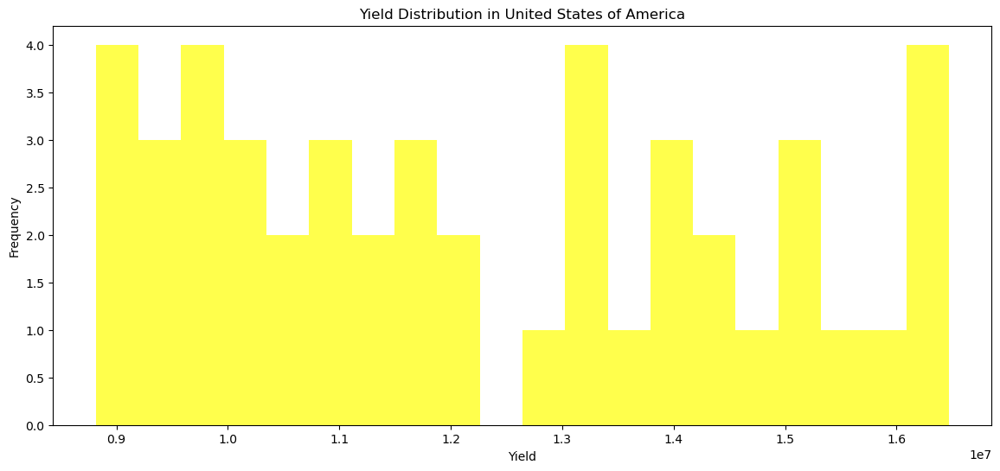

In [103]:
# Aggregating data
crop_yield = df_crops[df_crops['element'] == 'Yield']
crop_yield_agg = crop_yield.groupby(['country_or_area', 'year'])['value'].sum().reset_index()

# Histogram for a specific country
country = 'United States of America'
country_data = crop_yield_agg[crop_yield_agg['country_or_area'] == country]

plt.figure(figsize=(14, 6))
plt.hist(country_data['value'], bins=20, alpha=0.7, color='yellow')  # Set histogram color to yellow
plt.xlabel('Yield')
plt.ylabel('Frequency')
plt.title(f'Yield Distribution in {country}')
plt.show()


# HYPOTHESIS-7
Does the seasonal component of grape yield exhibit a consistent pattern over the months, suggesting predictable seasonal variations in grape production?

Based on the bar plot, the seasonal component of grape yield remains consistently around 1, indicating minimal seasonal variation. This suggests that grape production is stable and not significantly influenced by seasonal factors. The uniformity of the bars implies predictable yields throughout the year.

Consequently, the hypothesis of consistent seasonal variations in grape production is not supported. Instead, it indicates a lack of strong seasonal impact on grape yields.

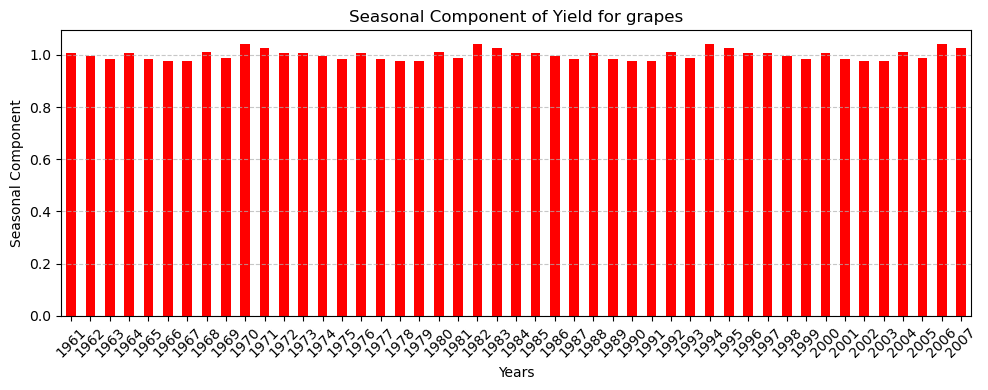

In [104]:
# Aggregating data
crop_yield = df_crops[df_crops['element'] == 'Yield']
crop_yield_agg = crop_yield.groupby(['year', 'category'])['value'].sum().unstack().fillna(0)

# Seasonal decomposition for a specific crop
crop = 'grapes'
crop_data = crop_yield_agg[crop].reset_index()
crop_data.set_index('year', inplace=True)

result = seasonal_decompose(crop_data, model='multiplicative', period=12)

# Extract the seasonal component
seasonal_component = result.seasonal

# Plotting the seasonal component as a bar plot
plt.figure(figsize=(10, 4))
seasonal_component.plot(kind='bar', color='red')  # Set color to red
plt.title(f'Seasonal Component of Yield for {crop}')
plt.xlabel('Years')
plt.ylabel('Seasonal Component')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

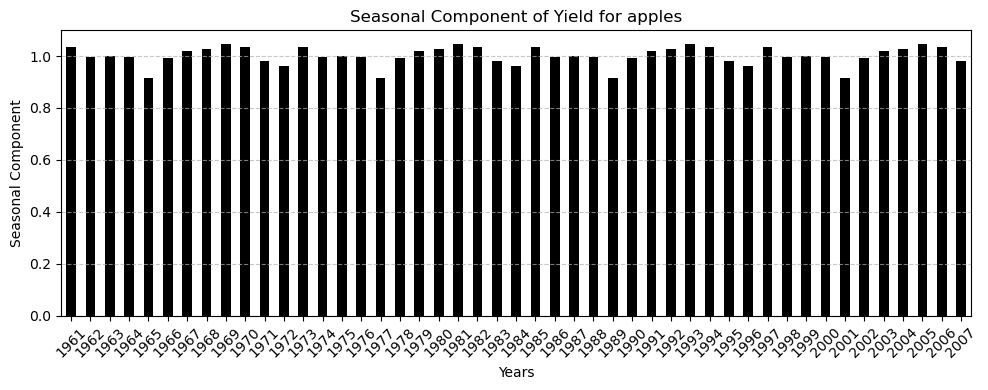

In [105]:
# Aggregating data
crop_yield = df_crops[df_crops['element'] == 'Yield']
crop_yield_agg = crop_yield.groupby(['year', 'category'])['value'].sum().unstack().fillna(0)

# Seasonal decomposition for a specific crop
crop = 'apples'
crop_data = crop_yield_agg[crop].reset_index()
crop_data.set_index('year', inplace=True)

result = seasonal_decompose(crop_data, model='multiplicative', period=12)

# Extract the seasonal component
seasonal_component = result.seasonal

# Plotting the seasonal component as a bar plot
plt.figure(figsize=(10, 4))
seasonal_component.plot(kind='bar', color='black')  # Set color to red
plt.title(f'Seasonal Component of Yield for {crop}')
plt.xlabel('Years')
plt.ylabel('Seasonal Component')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# HYPOTHESIS-8
Have the yields of apples, maize and grapes shown significant improvement over the past 20 years, indicating advancements in agricultural practices and technology?

Based on the line plot, both apple, maize and grape yields have shown significant improvement over the past 20 years. The yield for apples exhibits a steady upward trend, especially after the 1980s, with noticeable increases continuing into the 2000s. Similarly, grape, maize yields also show a consistent upward trend, although the increase is less steep compared to apples. These trends suggest advancements in agricultural practices and technology, contributing to the improved yields of both crops over time.

Therefore, the hypothesis that yields of apples, maize and grapes have significantly improved, indicating advancements in agriculture, is supported by the graph.

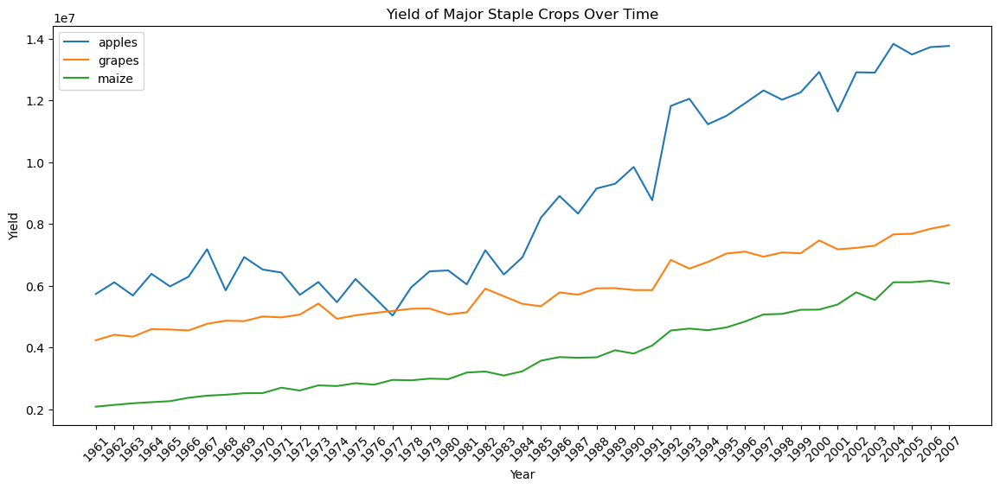

In [106]:
# Aggregating data
crop_yield = df_crops[df_crops['element'] == 'Yield']
staple_crops = ['apples', 'grapes', 'maize']

crop_yield_agg = crop_yield[crop_yield['category'].isin(staple_crops)].groupby(['year', 'category'])['value'].sum().reset_index()

# Line plot
plt.figure(figsize=(14, 6))
for crop in staple_crops:
    crop_data = crop_yield_agg[crop_yield_agg['category'] == crop]
    plt.plot(crop_data['year'], crop_data['value'], label=crop)

plt.xlabel('Year')
plt.ylabel('Yield')
plt.xticks(crop_data['year'], rotation=45) 
plt.title('Yield of Major Staple Crops Over Time')
plt.legend()
plt.show()


# HYPOTHESIS-9
Has the area harvested for grapes significantly increased over the past 20 years, indicating a growing trend in grape cultivation?

Based on the graph, the hypothesis of a consistent growing trend in grape cultivation over the past 20 years is not supported. The data shows fluctuations with no clear sustained increase. Periods of growth are present but are not continuous throughout the timeframe.

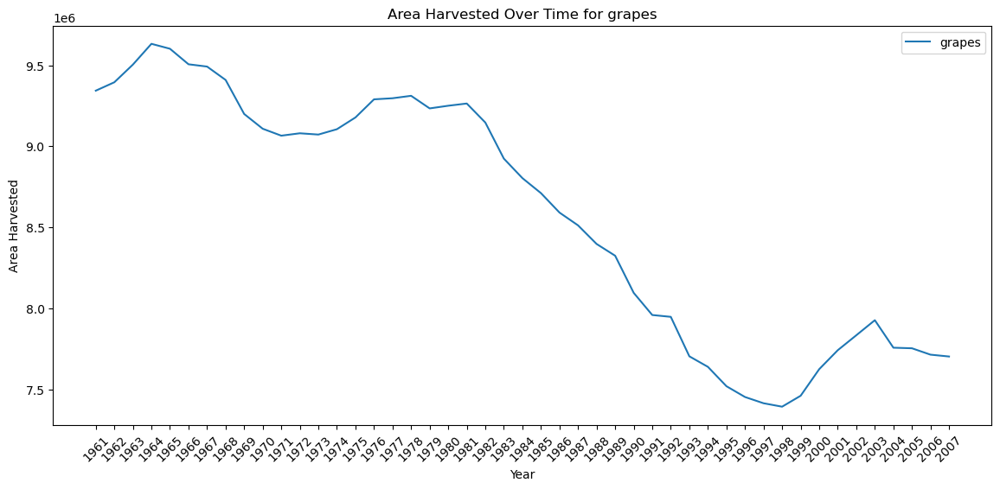

In [107]:
# Filter data for Area Harvested
area_harvested = df_crops[df_crops['element'] == 'Area Harvested']

# Aggregating data
area_harvested_agg = area_harvested.groupby(['year', 'category'])['value'].sum().reset_index()

# Line plot for a specific crop
crop = 'grapes'
crop_data = area_harvested_agg[area_harvested_agg['category'] == crop]

plt.figure(figsize=(14, 6))
plt.plot(crop_data['year'], crop_data['value'], label=crop)
plt.xlabel('Year')
plt.ylabel('Area Harvested')
plt.xticks(crop_data['year'], rotation=45) 
plt.title(f'Area Harvested Over Time for {crop}')
plt.legend()
plt.show()

# HYPOTHESIS-10
Has the area harvested for maize significantly increased over the past 20 years, indicating a growing trend in maize cultivation?

Based on the graph, the hypothesis of a consistent growing trend in maize cultivation over the past 20 years is increasing. The data shows clear sustained increase. Periods of growth are present and continuous throughout the timeframe.

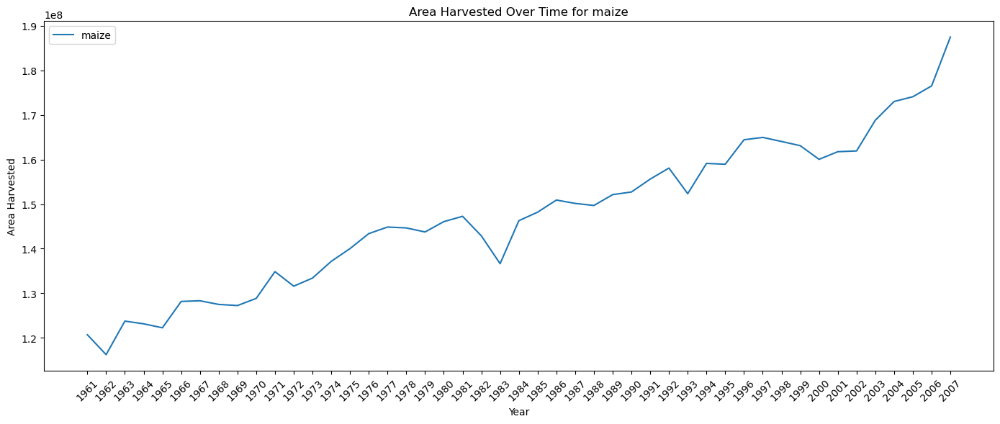

In [108]:
# Filter data for Area Harvested
area_harvested = df_crops[df_crops['element'] == 'Area Harvested']

# Aggregating data
area_harvested_agg = area_harvested.groupby(['year', 'category'])['value'].sum().reset_index()

# Line plot for a specific crop
crop = 'maize'
crop_data = area_harvested_agg[area_harvested_agg['category'] == crop]

plt.figure(figsize=(14, 6))
plt.plot(crop_data['year'], crop_data['value'], label=crop)
plt.xlabel('Year')
plt.ylabel('Area Harvested')
plt.title(f'Area Harvested Over Time for {crop}')
plt.xticks(crop_data['year'], rotation=45)  # Set x-tick labels to be all years with rotation
plt.legend()
plt.tight_layout()
plt.show()
